In [1]:
__author__ = "@Tssp"
__date__ = "19/10/21"
import numpy as np
from math import pi
import matplotlib.pyplot as plt
from matplotlib.ticker import AutoMinorLocator
from GPE_Split_Step_Fourier import GPE_Solver_2D
import os
plt.rc('text',usetex=True)
plt.rc('font',family='serif')
ref_ticksize = 16
plt.rcParams['xtick.labelsize']=ref_ticksize
plt.rcParams['legend.fontsize']=ref_ticksize
plt.rcParams['ytick.labelsize']=ref_ticksize
plt.rcParams['axes.labelsize']=ref_ticksize * 3/2
plt.rcParams['axes.titlesize']=ref_ticksize * 3/2

The soliton solutions are non-dispersive ones of the GPE. For $V=0$ and by setting the particle mass $m$ to 1, they are of the following form:

$$ \psi(x,t) = \left[ i\nu + \gamma^{-1} \tanh \left( \frac{x - (x_0 + \nu t}{\gamma} \right)\right]e^{-it}.$$

Being $\gamma^{-1}=\sqrt{1 - \nu^2}$ and $\nu$ the greyness, defined as the coefficient of the velocity of the soliton and the Bogoliubov speed of sound. In the special case of $\nu=0$ the soliton is called black. Here we solve the GPE for two solitons under a white noise.

In [2]:
Lx          = 64   # Domain size
Ly          = 64
Nx          = 256  # Number of grid points
Ny          = 256
dX          = Lx/Nx  # Cell size
dY          = Ly/Ny
x           = np.arange(-Lx/2, Lx/2, dX, dtype=complex)
y           = np.arange(-Ly/2, Ly/2, dY, dtype=complex)
X, Y        = np.meshgrid(x, y)
dT          = 0.01 # Time step size
kx          = 2*pi*np.fft.fftfreq(Nx, d=dX)
ky          = 2*pi*np.fft.fftfreq(Ny, d=dY)
Kx, Ky      = np.meshgrid(kx, ky)
g           = 1
figure_path = 'Figures/Soliton2D'
data_path   = 'Data/Soliton2D'
os.makedirs(figure_path, exist_ok=True)
os.makedirs(data_path, exist_ok=True)

In [3]:
def V(X):
    return -np.ones(X.shape)*0

V = V(X)

In [4]:
def dark_soliton(X, X0, nu=0):
    gamma = 1/np.sqrt(1 - nu**2)
    return (1j*nu + np.tanh((X - X0)/gamma)/gamma)*np.ones(X.shape)

def noise(sigma):
    return np.random.normal(1, sigma, (Nx, Ny)).astype(complex)

psi0 = dark_soliton(X, -10) * dark_soliton(X, 10) * noise(0.02)

/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


Text(0, 0.5, '$y[\\xi]$')

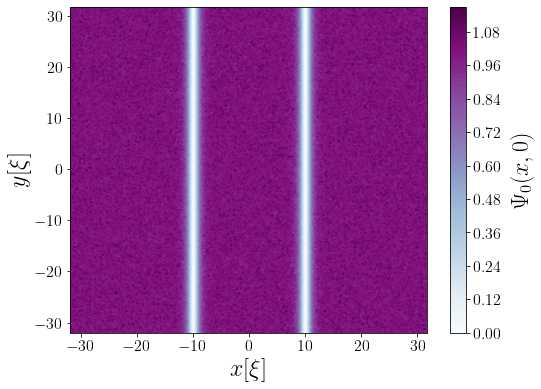

In [5]:
fig, ax = plt.subplots(figsize=(8,6))
c = ax.contourf(X, Y, np.abs(psi0)**2, levels=100, cmap='BuPu')
cbar = plt.colorbar(c)
cbar.ax.set_ylabel(r'$\Psi_0(x,0)$', labelpad=10)
ax.set_xlabel(r'$x[\xi]$')
ax.set_ylabel(r'$y[\xi]$')
#ax.set_ylim(-5, 5)
#ax.set_xlim(-5, 5)

In [6]:
GPE = GPE_Solver_2D(X, Y, V, psi0, Kx, Ky)
GPE.run_and_plot(14000, dT, g)


        GPE Solver initialized for a GRID from x=-32.0 to x=31.75 and 
        y=-32.0 to y=-32.0
        hbar=1 
        m=1
        


/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


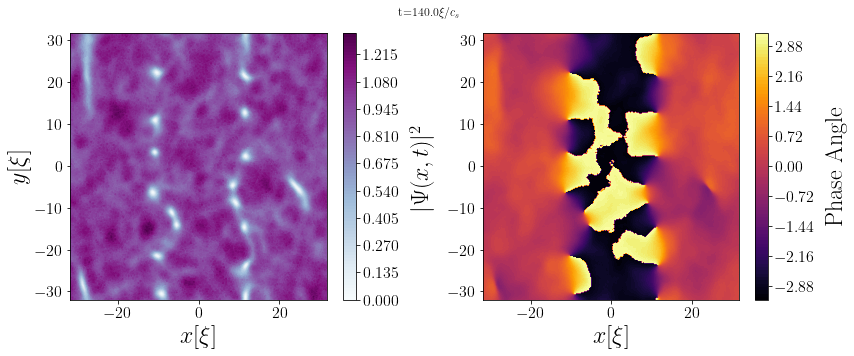

In [7]:
fig = plt.figure(figsize=(12,5), facecolor="white")

ax1 = plt.subplot(121)
cd = ax1.contourf(X, Y, GPE.prob_densities[14000,:,:], levels=100, cmap='BuPu')
cbar = plt.colorbar(cd)
cbar.ax.set_ylabel(r'$|\Psi(x,t)|^2$', labelpad=10)
ax1.set_xlabel(r'$x[\xi]$')
ax1.set_ylabel(r'$y[\xi]$')

ax2 = plt.subplot(122)
cd = ax2.contourf(X, Y, np.angle(GPE.psi_x[14000,:,:]), levels=100, cmap='inferno')
cbar = plt.colorbar(cd)#, ticks=[-np.pi, 0, np.pi])
#cbar.ax.set_yticklabels([r'$-\pi$', '0', r'$\pi$'])
cbar.ax.set_ylabel(r'Phase Angle', labelpad=10)
ax2.set_xlabel(r'$x[\xi]$')

plt.suptitle(f't={14000*dT}'+r'$\xi/c_s$')

plt.tight_layout()
#plt.savefig(figure_path+'/GPE_Soliton2D_14000.png', dpi=200)

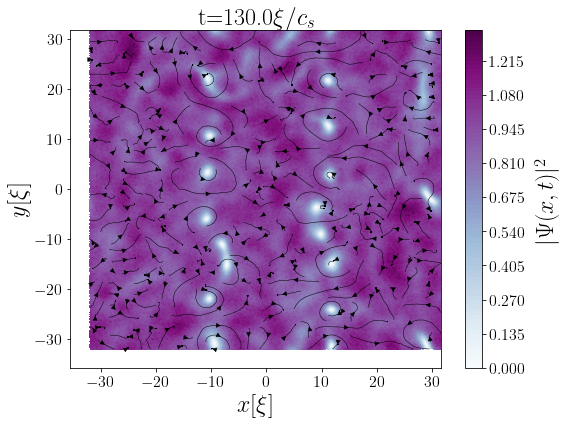

In [9]:
fig = plt.figure(figsize=(8,6), facecolor="white")

ax1 = plt.subplot()
cd = ax1.contourf(X, Y, GPE.prob_densities[13000,:,:], levels=100, cmap='BuPu')
cbar = plt.colorbar(cd)
cbar.ax.set_ylabel(r'$|\Psi(x,t)|^2$', labelpad=10)
ax1.set_xlabel(r'$x[\xi]$')
ax1.set_ylabel(r'$y[\xi]$')

grad = np.gradient(np.angle(GPE.psi_x[13000,:,:]))
plt.streamplot(np.real(GPE.x), np.real(GPE.y), np.real(grad[1]), np.real(grad[0]), color='k',\
               density=1, linewidth=0.5)

plt.title(f't={13000*dT}'+r'$\xi/c_s$')

plt.tight_layout()
#plt.savefig(figure_path+'/GPE_Velocity2D_14000.png', dpi=200)

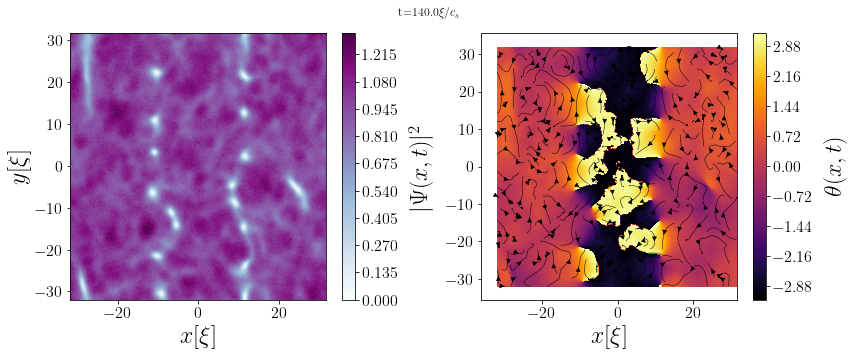

In [10]:
fig = plt.figure(figsize=(12,5), facecolor="white")

ax1 = plt.subplot(121)
cd = ax1.contourf(GPE.x, GPE.y, GPE.prob_densities[14000,:,:], levels=100, cmap='BuPu')
cbar = plt.colorbar(cd)
cbar.ax.set_ylabel(r'$|\Psi(x,t)|^2$', labelpad=10)
ax1.set_xlabel(r'$x[\xi]$')
ax1.set_ylabel(r'$y[\xi]$')

ax2 = plt.subplot(122)
theta = np.angle(GPE.psi_x[14000,:,:])
cd = ax2.contourf(X, Y, theta, levels=100, cmap='inferno')
cbar = plt.colorbar(cd)
cbar.ax.set_ylabel(r'$|\theta(x, y)|^2$', labelpad=10)

grad = np.gradient(theta)
ax2.streamplot(np.real(GPE.x), np.real(GPE.y), np.real(grad[0]), np.real(grad[1]), color='k',\
               density=1, linewidth=0.5)
ax1.set_xlabel(r'$x[\xi]$')
ax1.set_ylabel(r'$y[\xi]$')
cbar.ax.set_ylabel(r'$\theta(x,t)$', labelpad=10)
ax2.set_xlabel(r'$x[\xi]$')

plt.suptitle(f't={14000*dT}'+r'$\xi/c_s$')

plt.tight_layout()
plt.savefig(figure_path+'/GPE_Velocity2D_14000.png', dpi=200)

# GIF

/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/p

/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/p

/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/p

/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/p

/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/p

/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/p

/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/anaconda3/lib/p

IndexError: index 14050 is out of bounds for axis 0 with size 14001

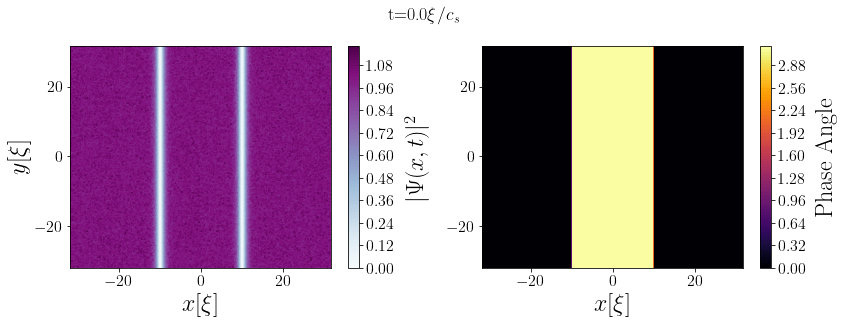

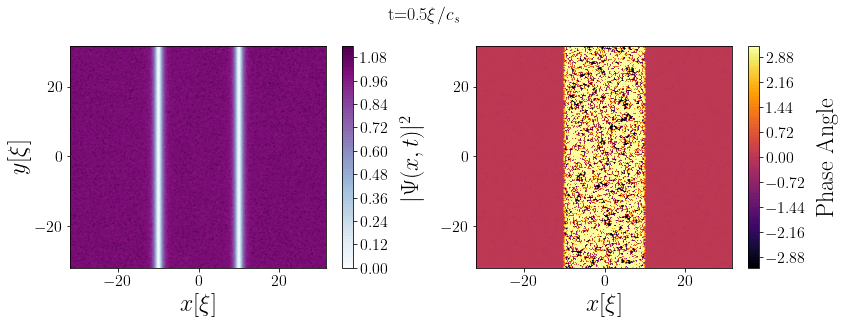

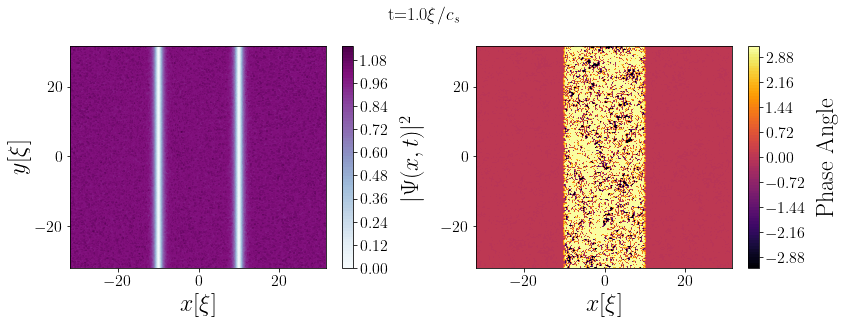

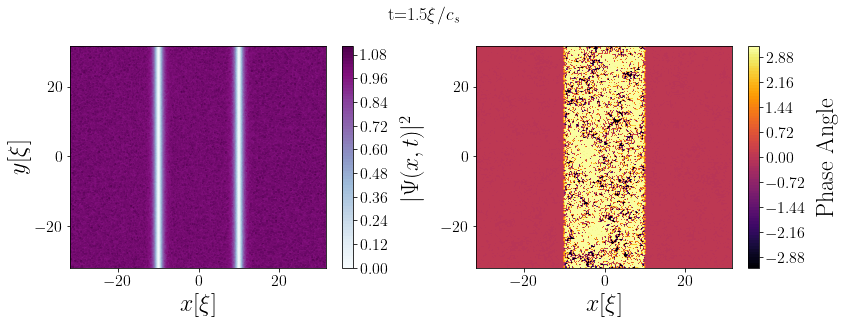

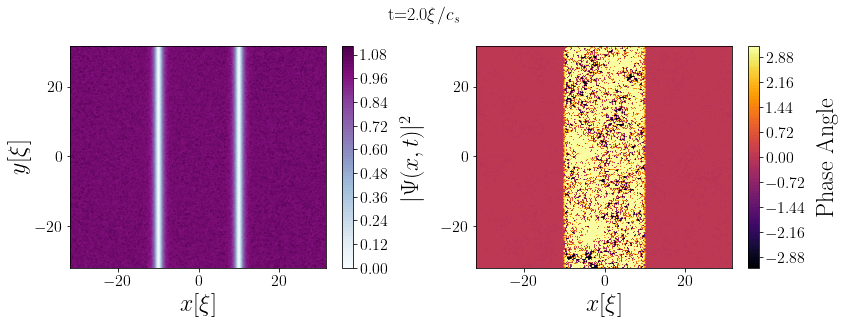

...

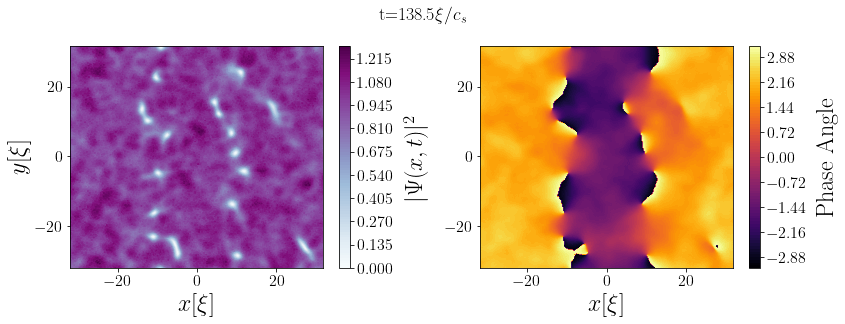

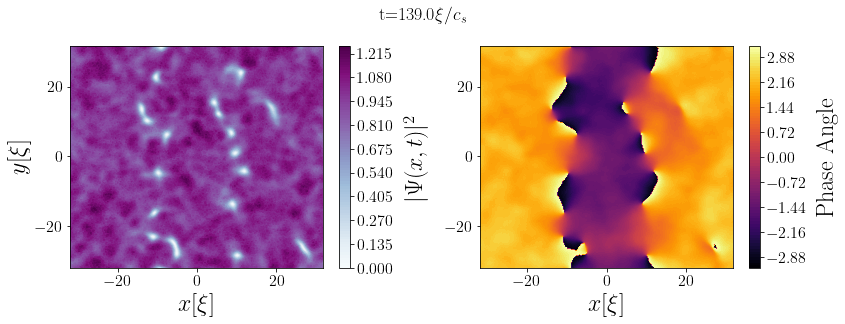

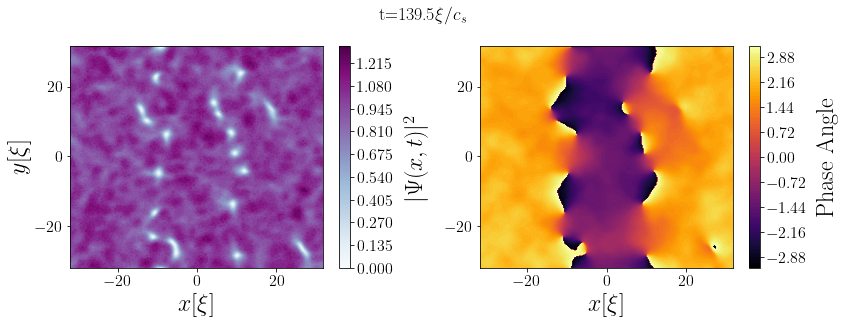

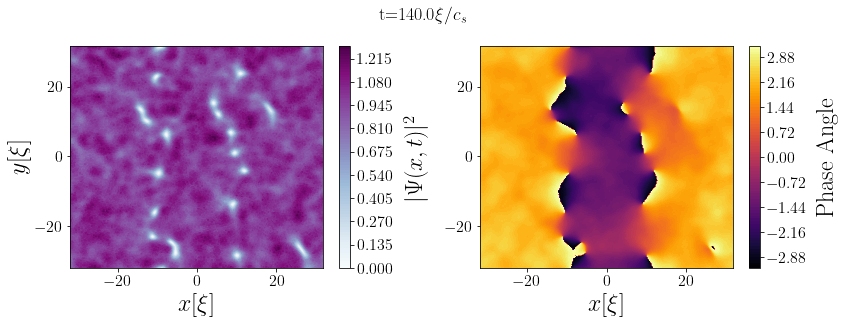

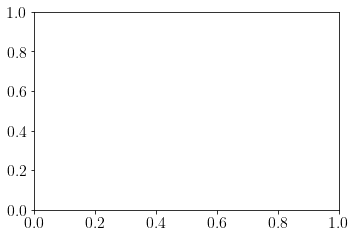

In [168]:
for i in range(len(GPE.prob_densities)):
    fig = plt.figure(figsize=(12,8))

    ax1 = plt.subplot(221)
    cd = ax1.contourf(GPE.x, GPE.y, GPE.prob_densities[i*50,:,:], levels=100, cmap='BuPu')
    cbar = plt.colorbar(cd)
    cbar.ax.set_ylabel(r'$|\Psi(x,t)|^2$', labelpad=10)
    ax1.set_xlabel(r'$x[\xi]$')
    ax1.set_ylabel(r'$y[\xi]$')

    ax2 = plt.subplot(222)
    cd = ax2.contourf(X, Y, np.angle(GPE.psi_x[i*50,:,:]), levels=100, cmap='inferno')
    cbar = plt.colorbar(cd)#, ticks=[-np.pi, 0, np.pi])
    #cbar.ax.set_yticklabels([r'$-\pi$', '0', r'$\pi$'])
    cbar.ax.set_ylabel(r'Phase Angle', labelpad=10)
    ax2.set_xlabel(r'$x[\xi]$')
    plt.suptitle(f't={round(i*50*dT, 2)}'+r'$\xi/c_s$')
    plt.tight_layout()
    
    plt.savefig(figure_path+f'/GPE_soliton2D{i}.png', dpi=300, bbox_inches='tight')

In [169]:
from PIL import Image
imgs = [Image.open(figure_path+f'/GPE_soliton2D{i}.png') for i in range(280)]
imgs[0].save(figure_path+"/GPE_soliton2D_v2.gif", save_all=True, append_images=imgs[1:], duration=50, loop=0)